In [12]:
from time import time
s = time()

import os

import matplotlib
import matplotlib.pyplot as plt

# import io
# import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image#, ImageDraw, ImageFont
ImageFile.LOAD_TRUNCATED_IMAGES = True
import tensorflow as tf

%matplotlib inline

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

print(time()-s)

0.006726980209350586


In [2]:
s = time()
def load_image_into_numpy_array(path):
    img_data = tf.io.gfile.GFile(path, 'rb').read()
    image = Image.open(BytesIO(img_data))
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

def get_keypoint_tuples(eval_config):
    tuple_list = []
    kp_list = eval_config.keypoint_edge
    for edge in kp_list:
        tuple_list.append((edge.start, edge.end))
    return tuple_list

def load_label_map():
    label_map_path = 'object_detection/data/mscoco_label_map.pbtxt'
    label_map = label_map_util.load_labelmap(label_map_path)
    categories = label_map_util.convert_label_map_to_categories(
                                                                label_map,
                                                                max_num_classes=label_map_util.get_max_label_map_index(label_map),
                                                                use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

    return category_index, label_map_dict

def load_model():
    model_name = 'centernet_resnet101_v1_fpn_512x512_coco17_tpu-8'
    pipeline_config = os.path.join(os.getcwd(), 'object_detection', 'test_data', model_name, 'pipeline.config')
    model_dir = os.path.join(os.getcwd(), 'object_detection', 'test_data', model_name, 'checkpoint')

    # Load pipeline config and build a detection model
    configs = config_util.get_configs_from_pipeline_file(pipeline_config)
    model_config = configs['model']
    # model_config.center_net.object_center_params.max_box_predictions = 200

    detection_model = model_builder.build(model_config=model_config, is_training=False)

    # Restore checkpoint
    ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
    ckpt.restore(os.path.join(model_dir, 'ckpt-0')).expect_partial()
    return detection_model, configs

def get_model_detection_function(model):
    """Get a tf.function for detection."""

    @tf.function
    def detect_fn(image):
        """Detect objects in image."""

        image, shapes = model.preprocess(image)
        prediction_dict = model.predict(image, shapes)
        detections = model.postprocess(prediction_dict, shapes)

        return detections, prediction_dict, tf.reshape(shapes, [-1])

    return detect_fn

detection_model, configs = load_model()
detect_fn = get_model_detection_function(detection_model)

print(time()-s)

33.016817808151245


In [3]:
os.listdir('data/images')

['202008111208', 'p202008081844', 'p202008082112']

In [4]:
data_dir = os.path.join(os.getcwd(), 'data', 'images', '202008111208')
category_index, label_map_dict = load_label_map()

82 images to process
1001_1203_20200811120840_c9c310.jpg


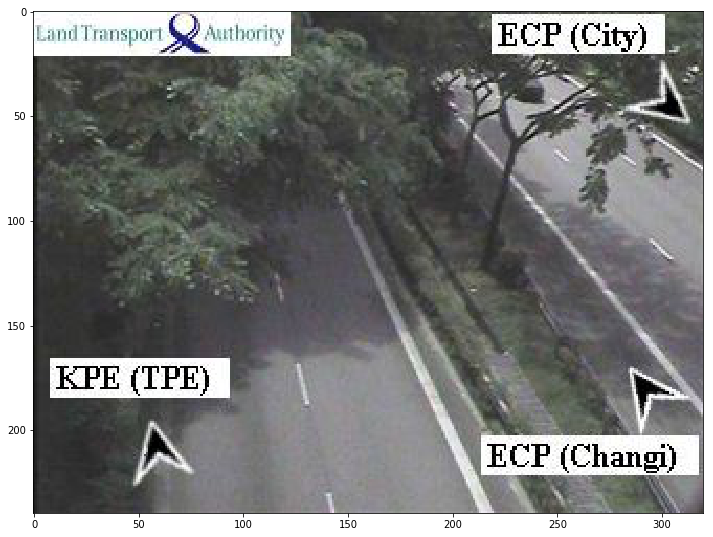

1.6755261421203613

1002_1203_20200811120840_07062b.jpg


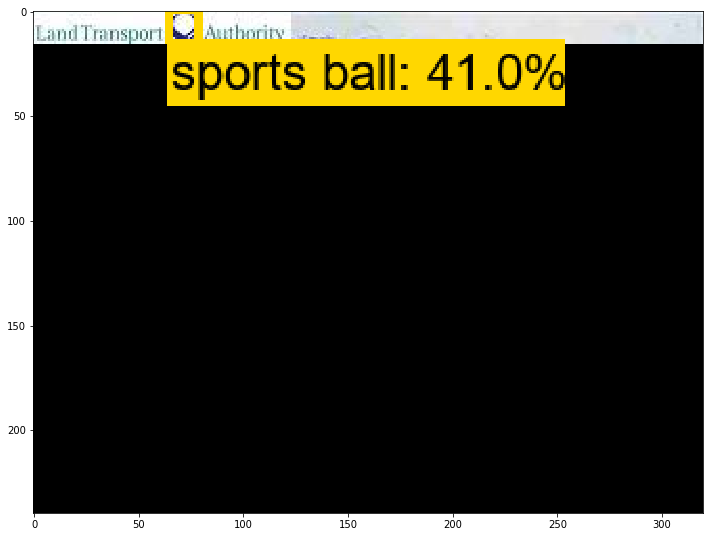

1.512472152709961

1003_1203_20200811120840_33f2f4.jpg


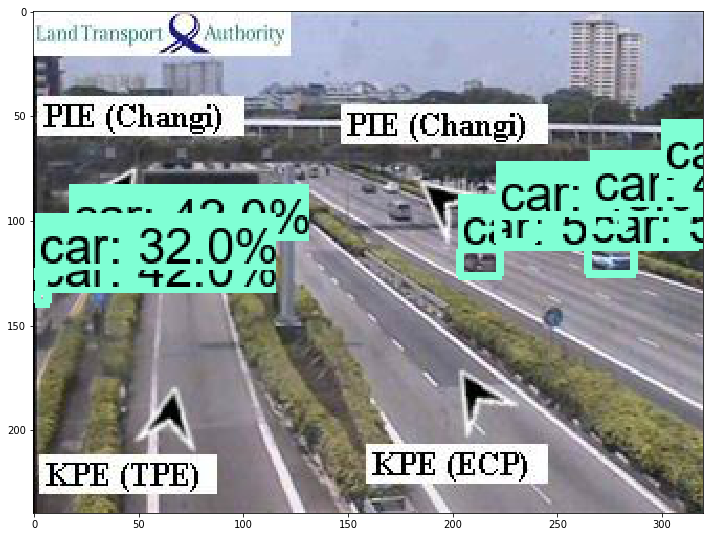

1.7812678813934326

1004_1203_20200811120839_dedeb3.jpg


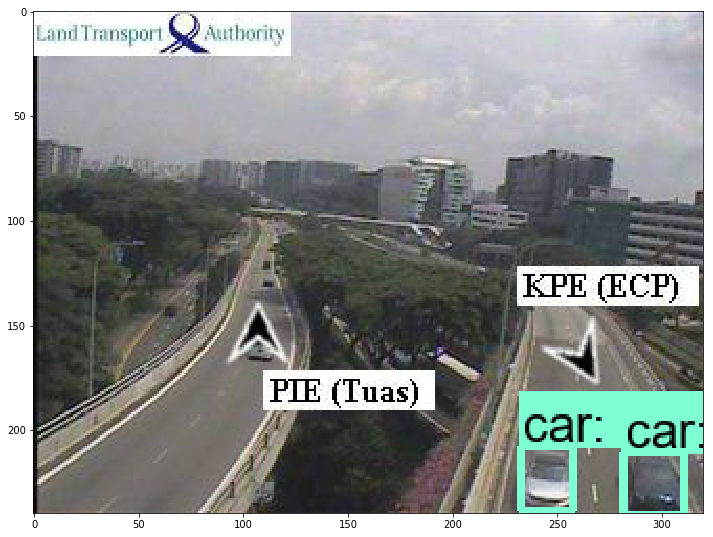

1.75107741355896

1005_1203_20200811120839_606766.jpg


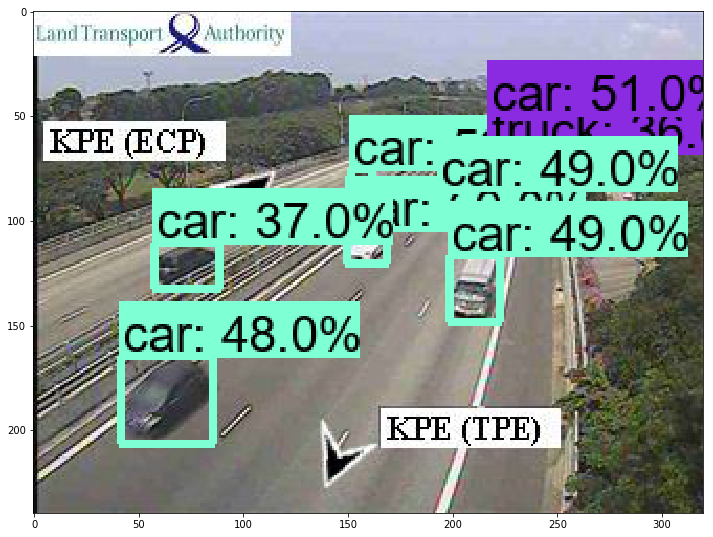

1.6921358108520508

1006_1203_20200811120839_753de4.jpg


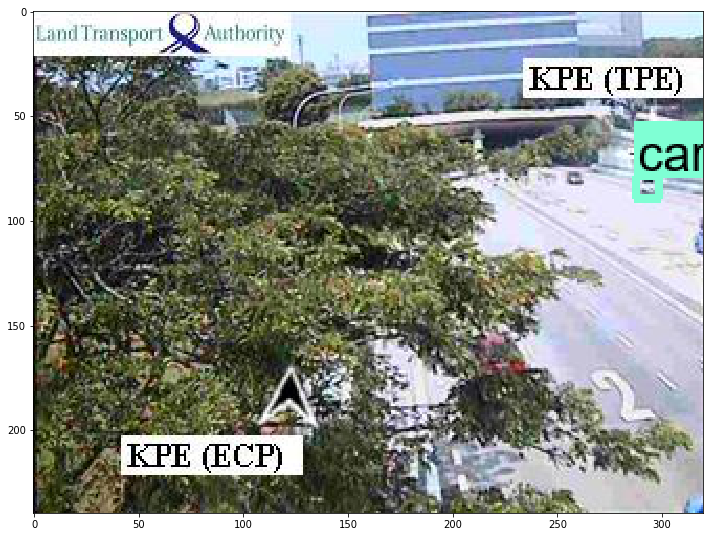

1.8151884078979492

1501_1203_20200811120840_52dd32.jpg


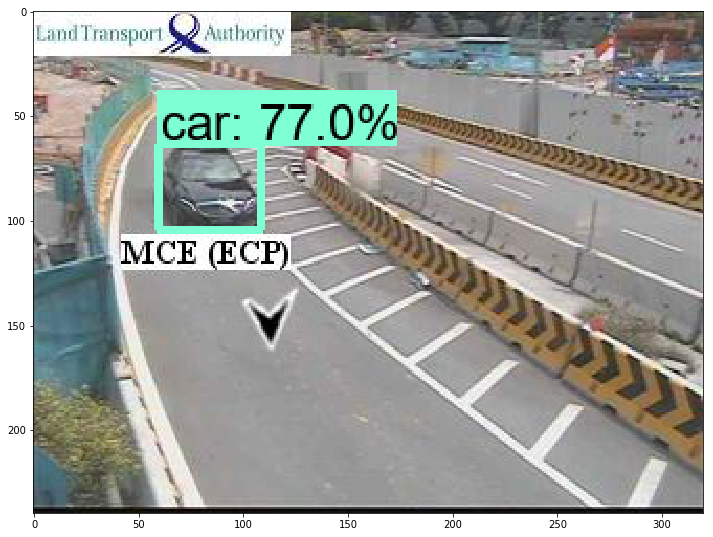

1.7448201179504395

1502_1203_20200811120840_7154c8.jpg


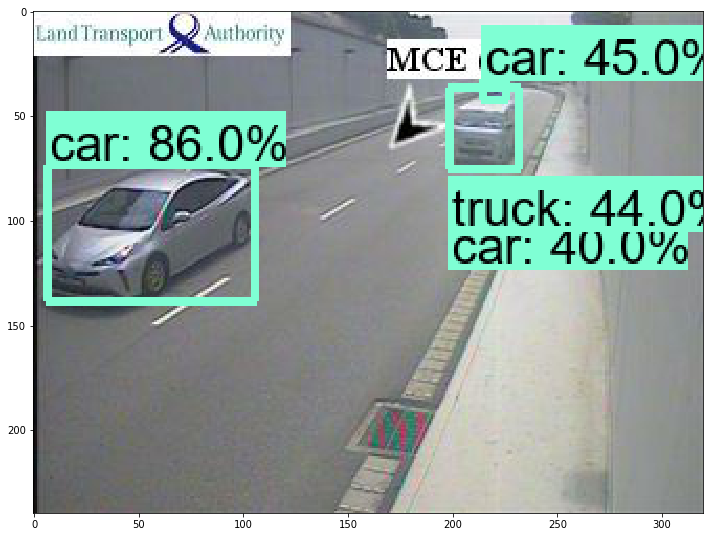

1.754077672958374

1503_1203_20200811120840_f2f9be.jpg


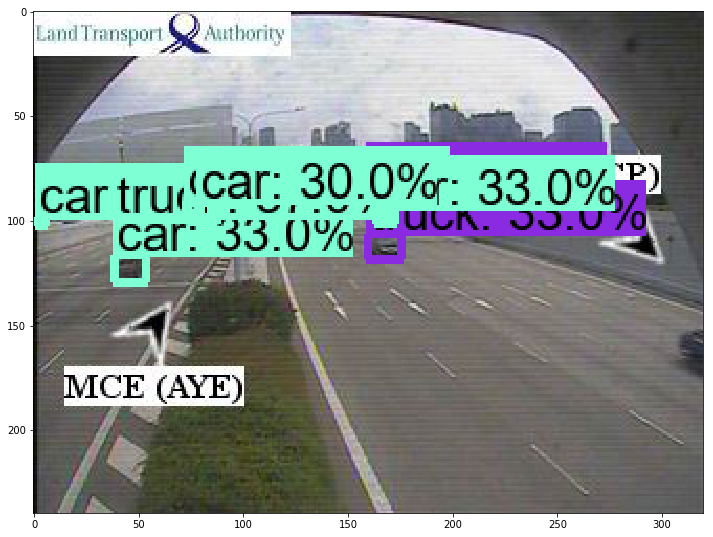

1.6936984062194824

1504_1203_20200811120840_34c07c.jpg


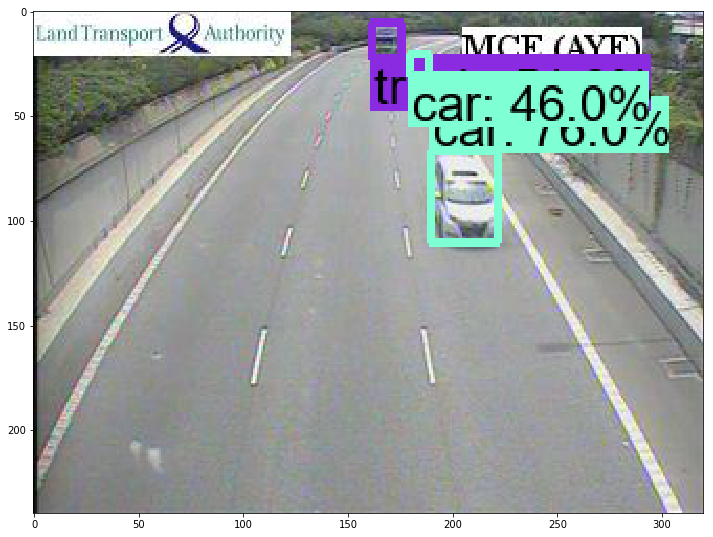

1.768890619277954

1505_1203_20200811120840_92f741.jpg


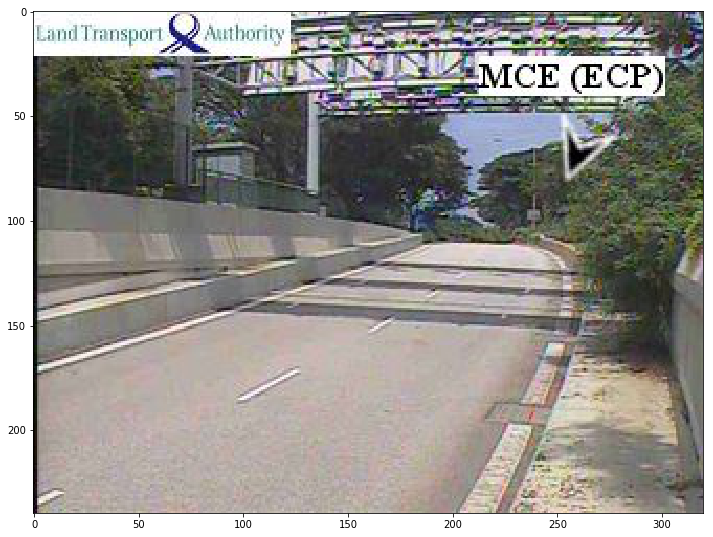

1.697901725769043

1701_1206_20200811120826_26869e.jpg


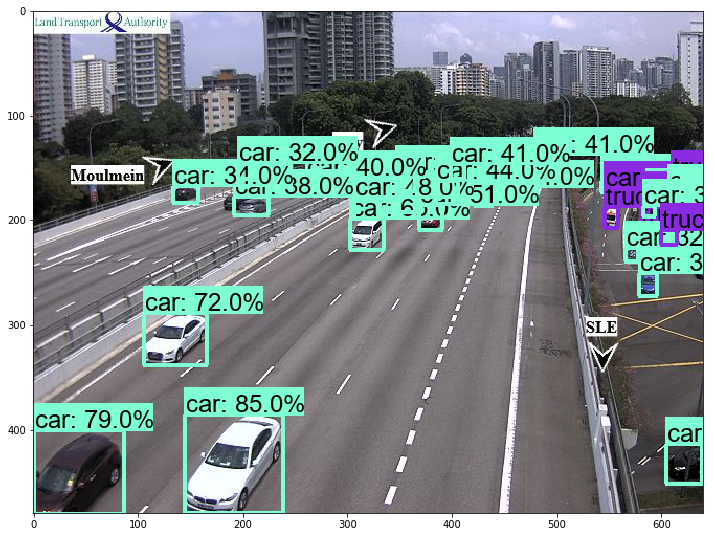

6.760277032852173

1702_1206_20200811120825_3e6512.jpg


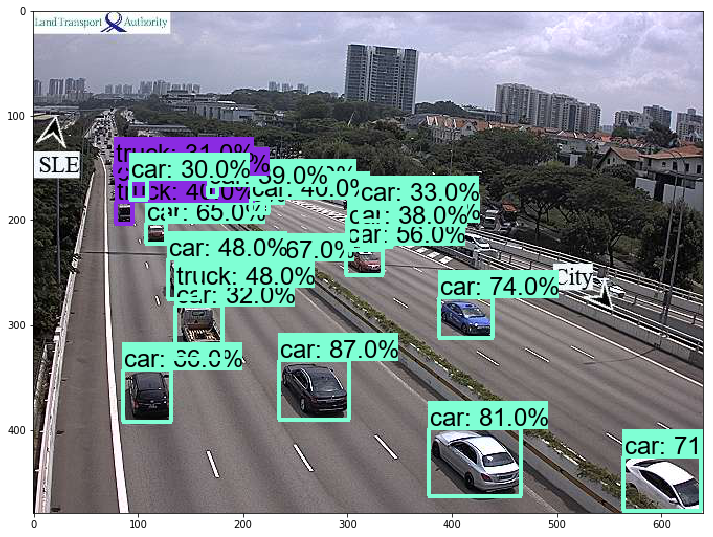

2.449862480163574

1706_1205_20200811120824_e74ae8.jpg


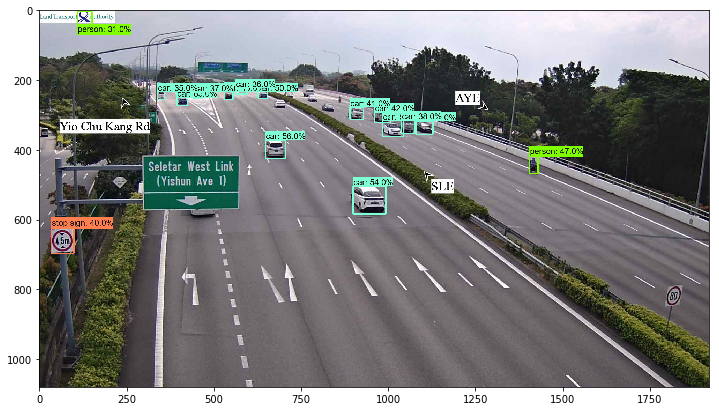

9.356688976287842

1709_1206_20200811120822_45c6a9.jpg


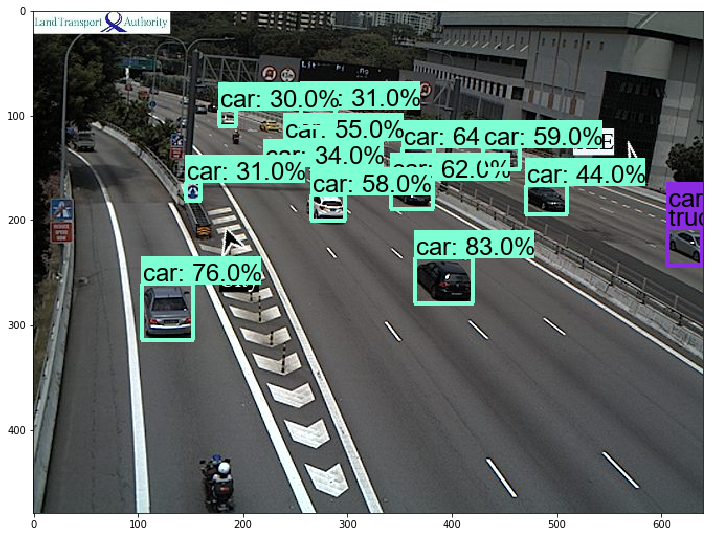

2.433281183242798

2701_1206_20200811120828_675a0a.jpg


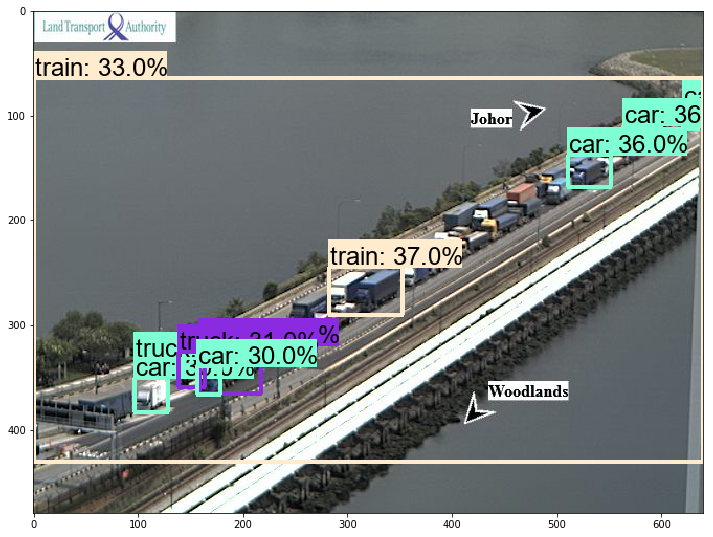

2.306730270385742

2702_1206_20200811120827_c84cfe.jpg


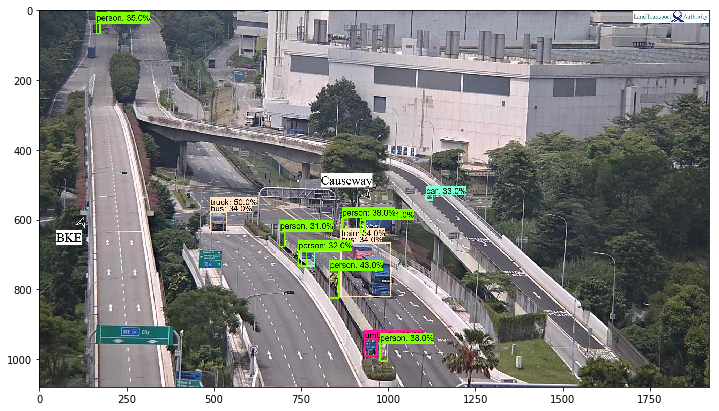

5.542666435241699

2703_1206_20200811120827_0182e5.jpg


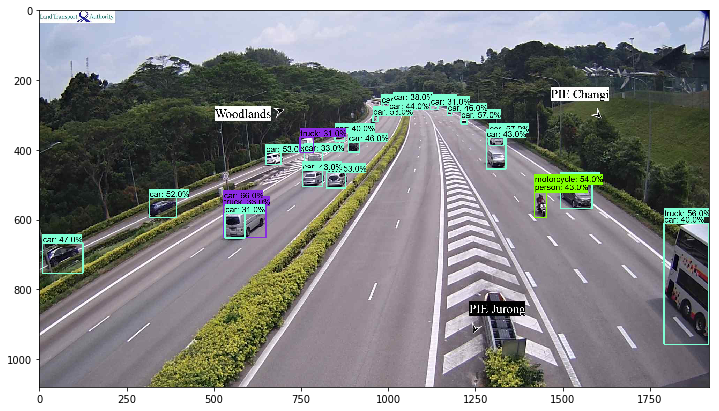

6.625251054763794

2704_1206_20200811120827_7050bf.jpg


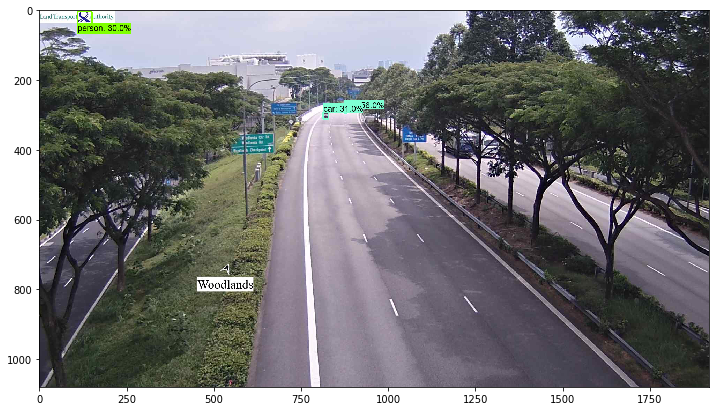

5.289590120315552

2705_1206_20200811120826_a58a8d.jpg


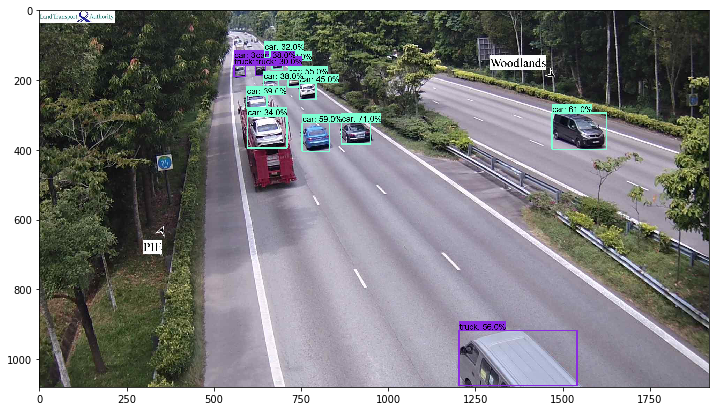

5.599085807800293

2706_1205_20200811120825_4173cc.jpg


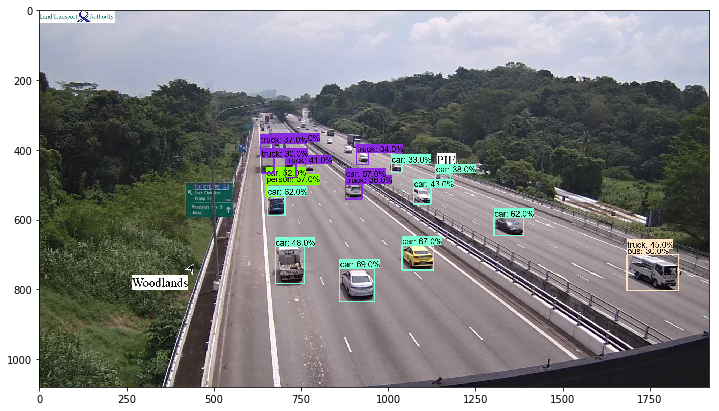

5.5070319175720215

2707_1206_20200811120825_fbf99e.jpg


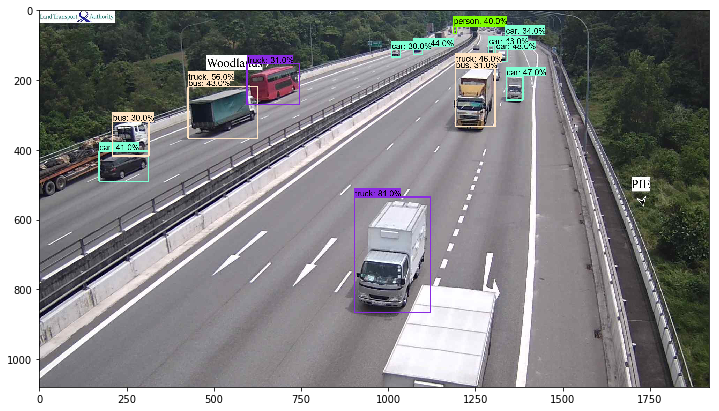

5.556834936141968

2708_1206_20200811120825_4728f9.jpg


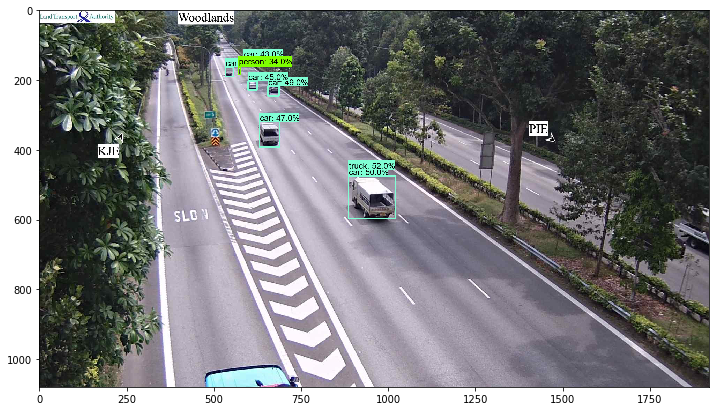

5.515744209289551

3702_1206_20200811120830_685f50.jpg


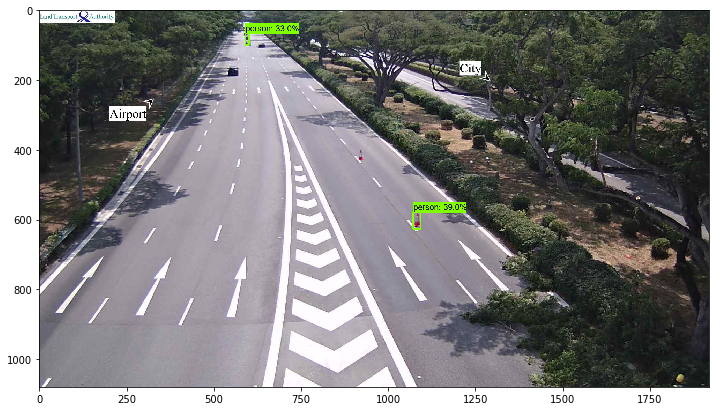

5.4927825927734375

3704_1206_20200811120829_6ff6c5.jpg


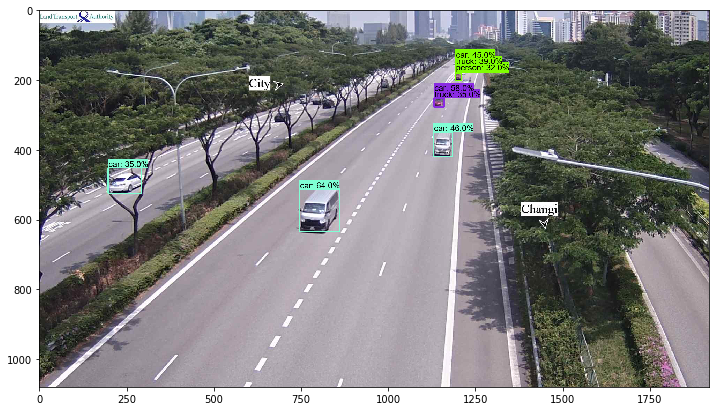

5.7111124992370605

3705_1206_20200811120828_d801eb.jpg


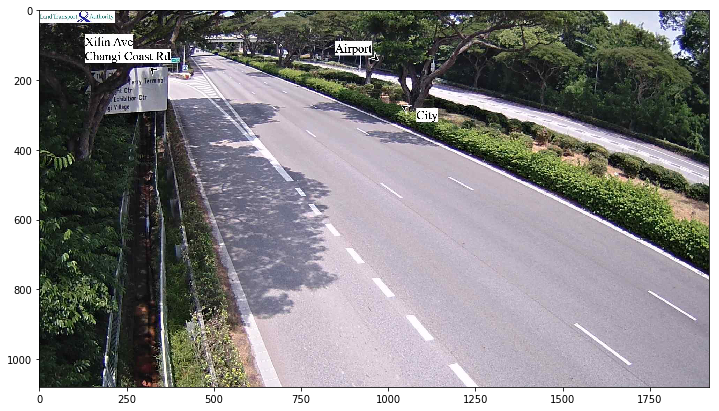

6.409675359725952

3793_1206_20200811120806_a83ac2.jpg


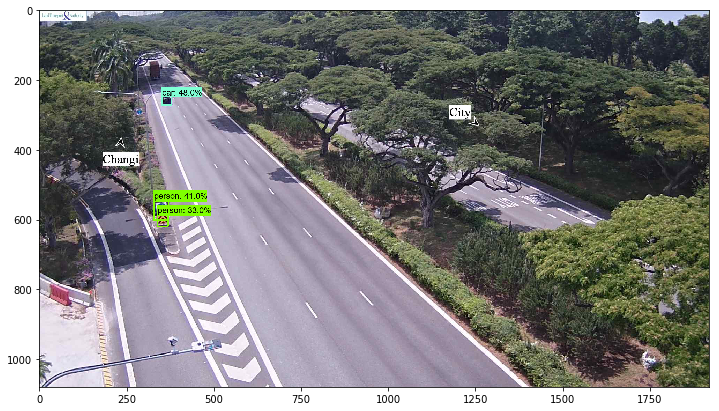

5.36120080947876

3795_1206_20200811120804_37eea5.jpg


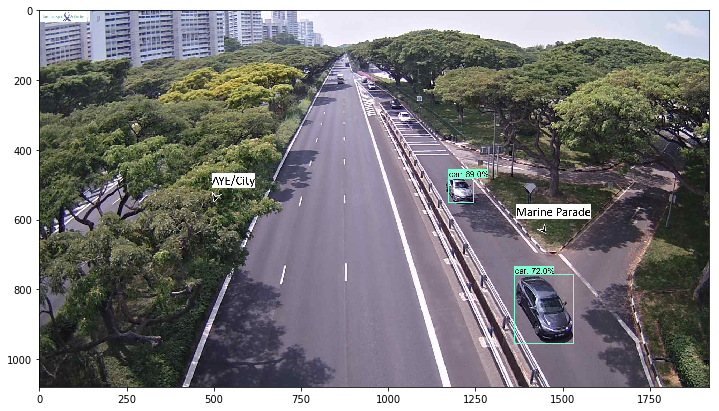

5.253742694854736

3796_1206_20200811120803_39c711.jpg


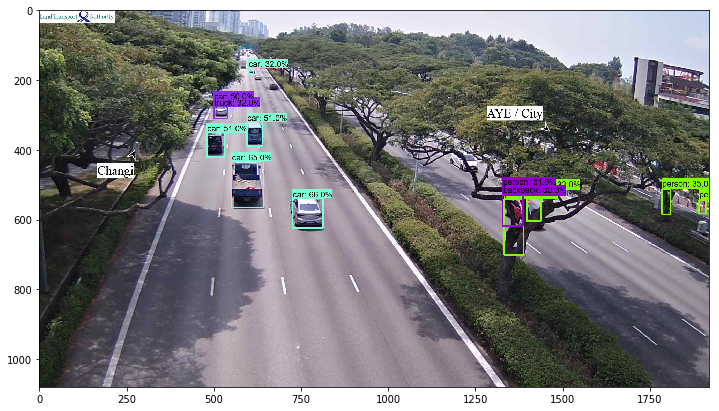

5.813559293746948

3797_1206_20200811120801_b53471.jpg


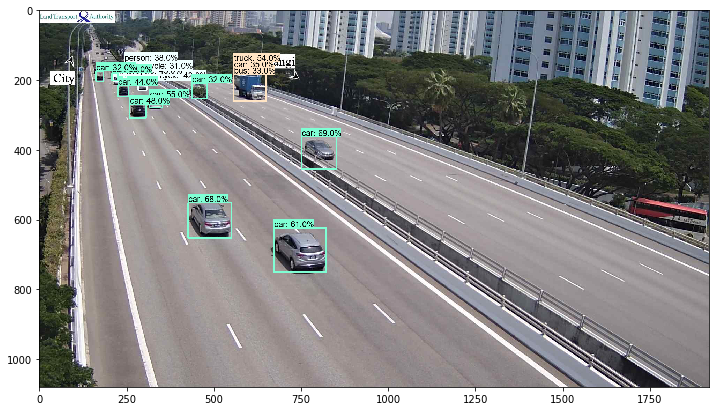

6.03282618522644

3798_1206_20200811120800_e995bb.jpg


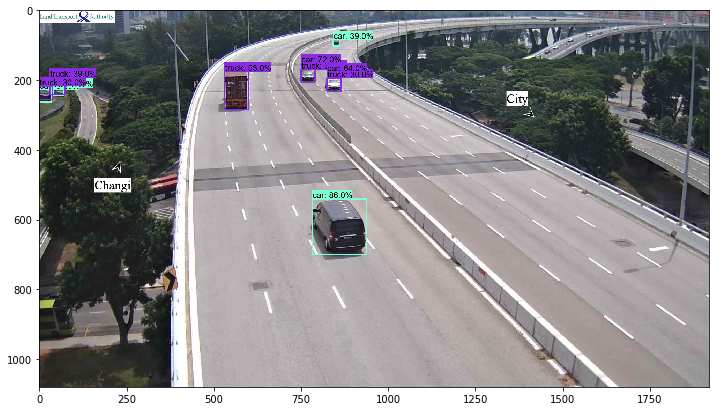

6.124491930007935

4701_1206_20200811120832_32a1b0.jpg


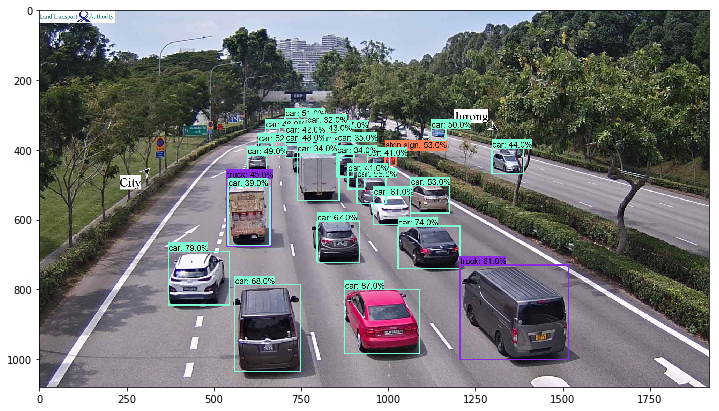

6.521950721740723

4702_1206_20200811120832_3d687b.jpg


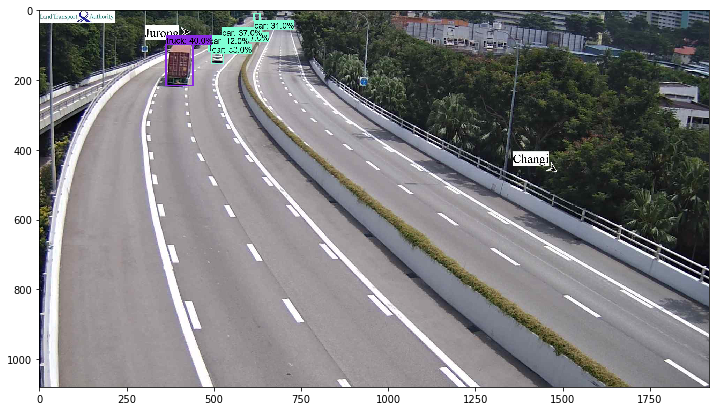

9.1281578540802

4703_1206_20200811120832_77ab30.jpg


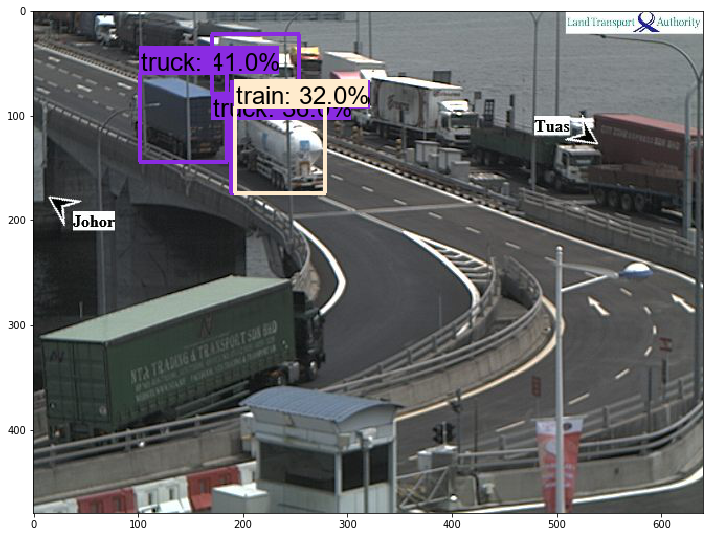

4.045394420623779

4704_1206_20200811120831_c8a914.jpg


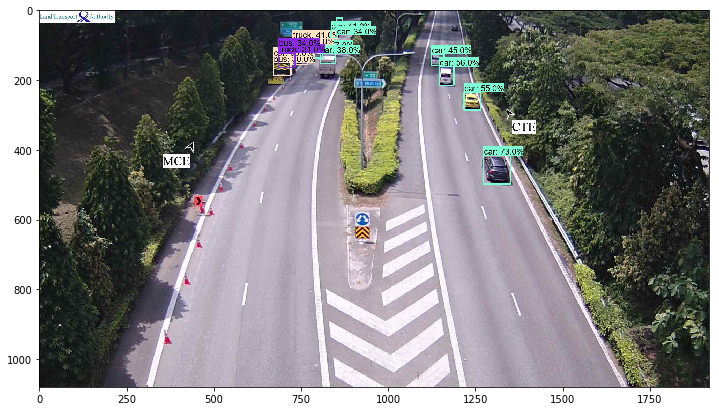

8.40363883972168

4705_1206_20200811120831_96feb7.jpg


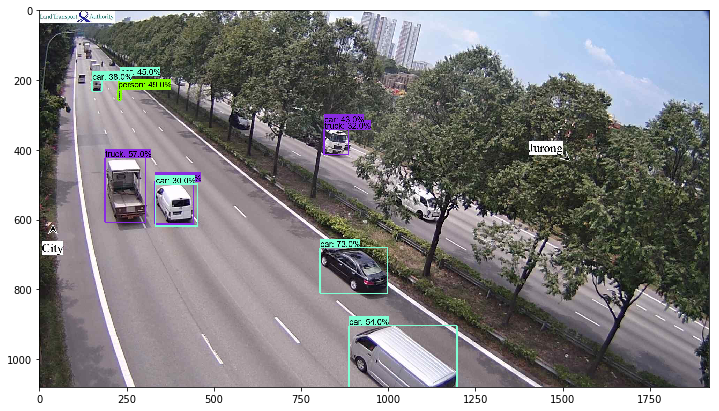

6.967167615890503

4706_1206_20200811120831_66ae6d.jpg


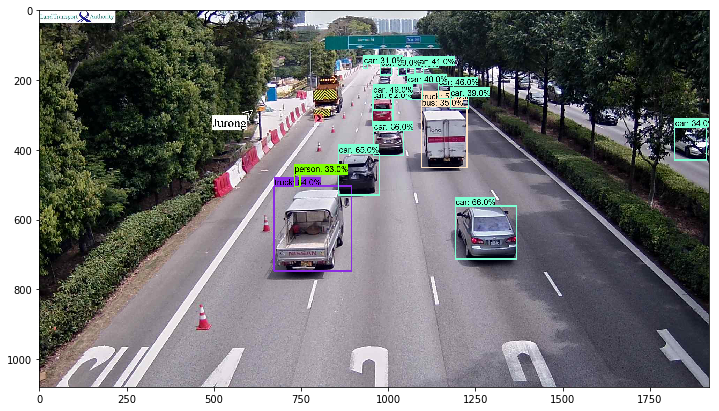

6.798128843307495

4707_1206_20200811120830_2e2446.jpg


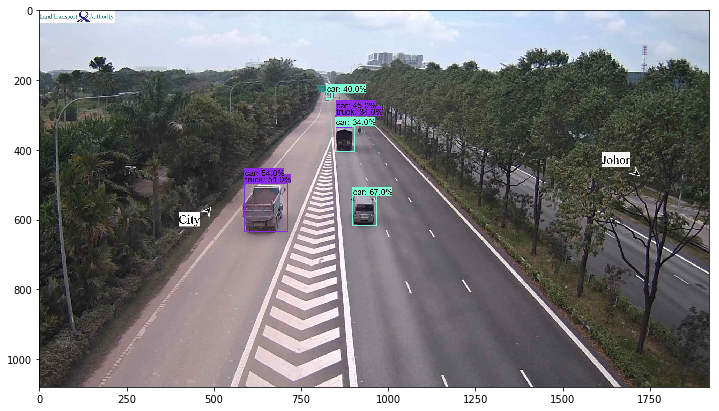

7.161446571350098

4708_1206_20200811120829_198312.jpg


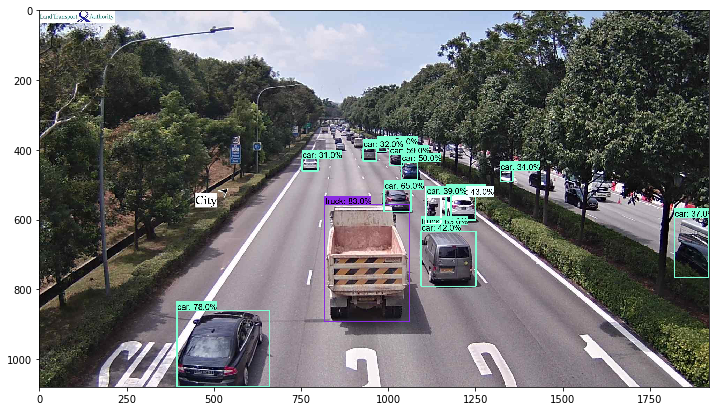

6.809509515762329

4709_1206_20200811120829_e498b9.jpg


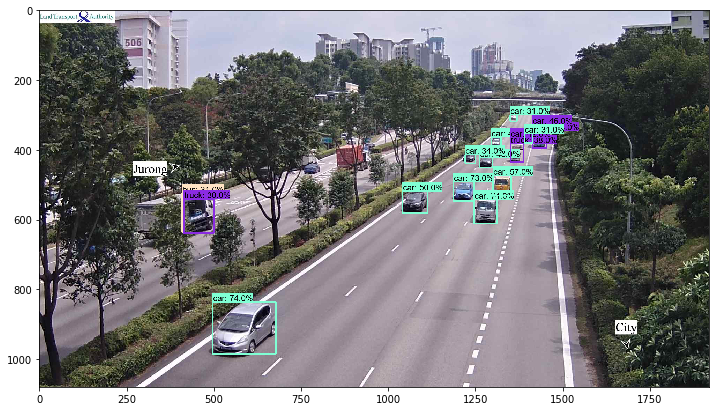

7.21698260307312

4710_1206_20200811120821_69876d.jpg


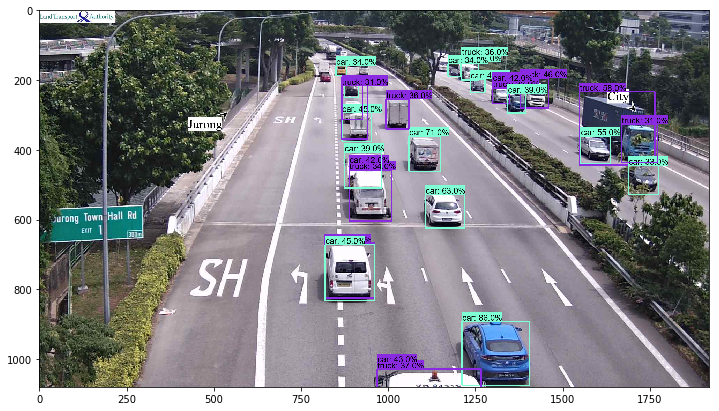

7.020623207092285

4712_1206_20200811120821_9a40e3.jpg


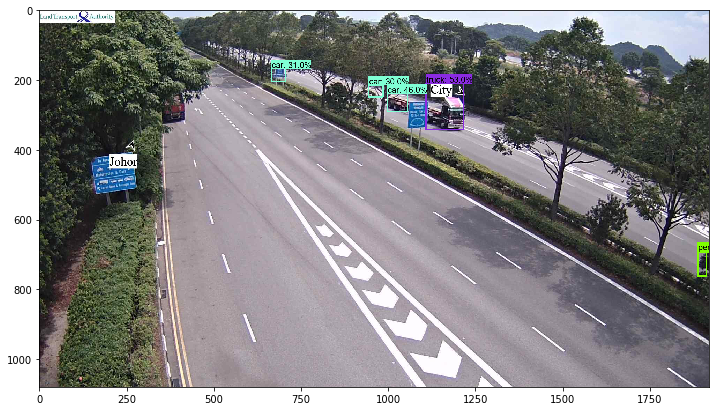

6.23947811126709

4713_1206_20200811120820_40c75f.jpg


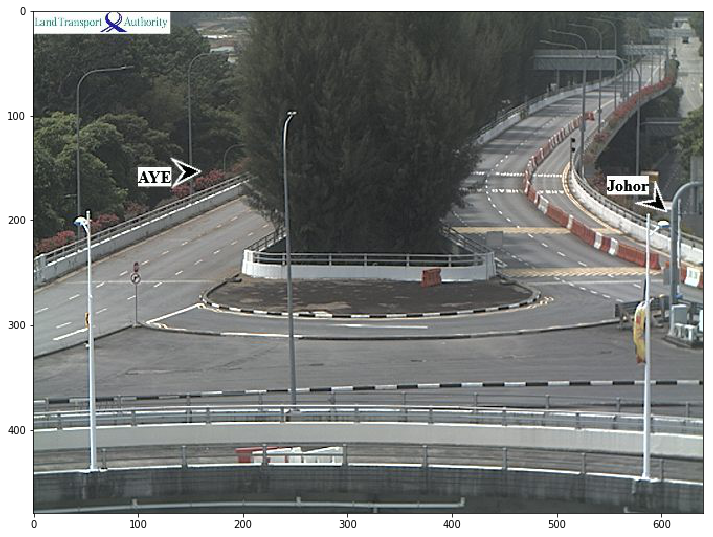

3.0848162174224854

4714_1206_20200811120819_af802d.jpg


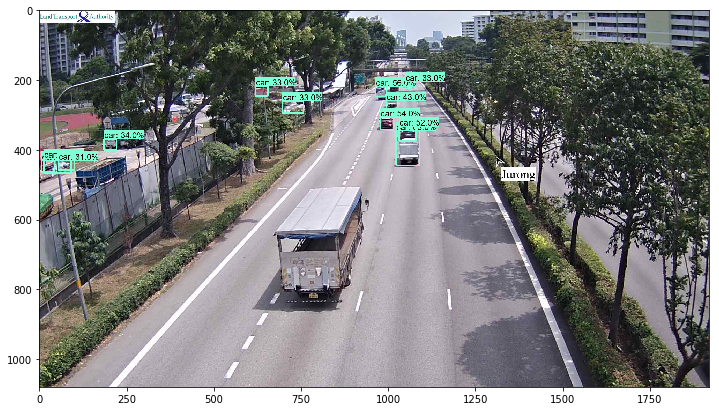

6.757828950881958

4716_1206_20200811120818_ece5d8.jpg


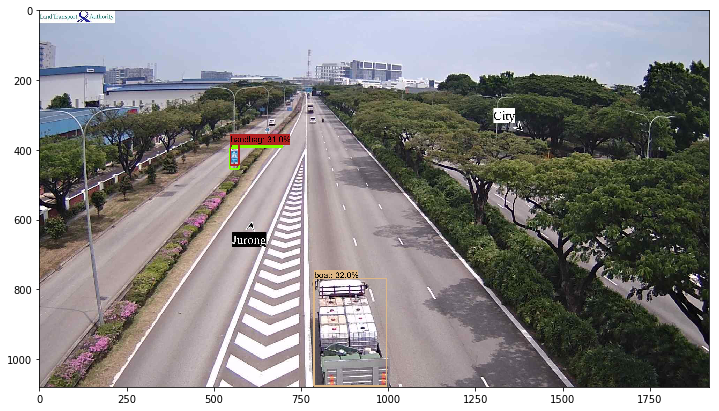

6.400294780731201

4798_1206_20200811120806_f7cc6c.jpg


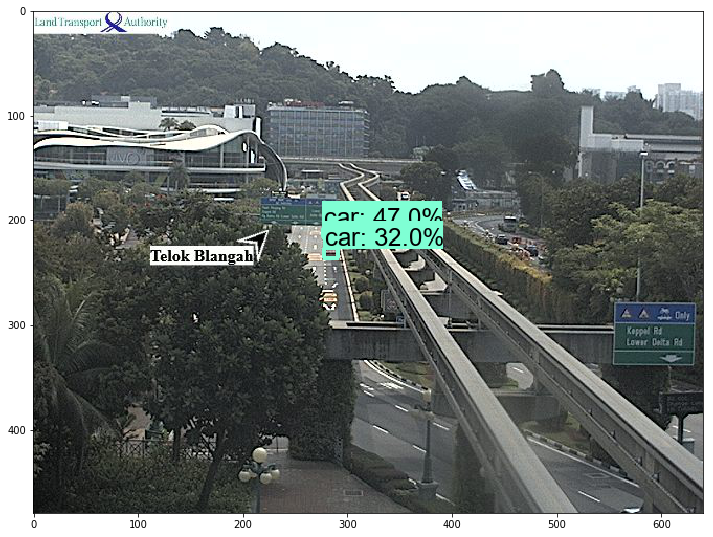

2.756561040878296

4799_1206_20200811120805_b43fde.jpg


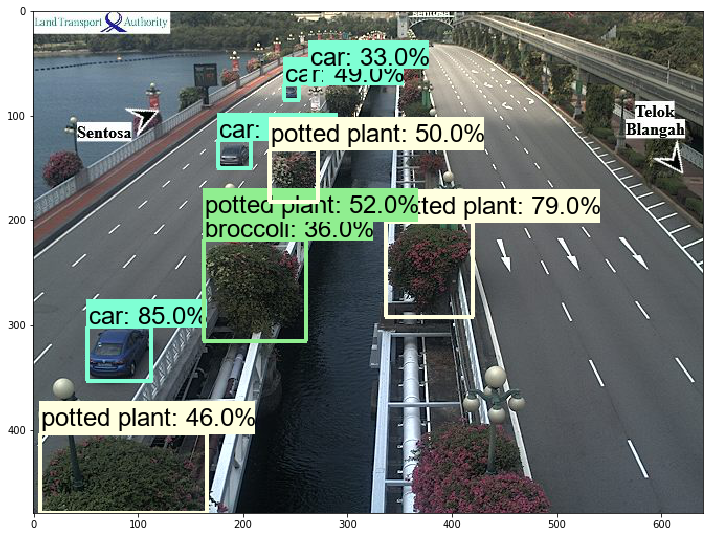

2.5215113162994385

5794_1205_20200811120811_ca5dcd.jpg


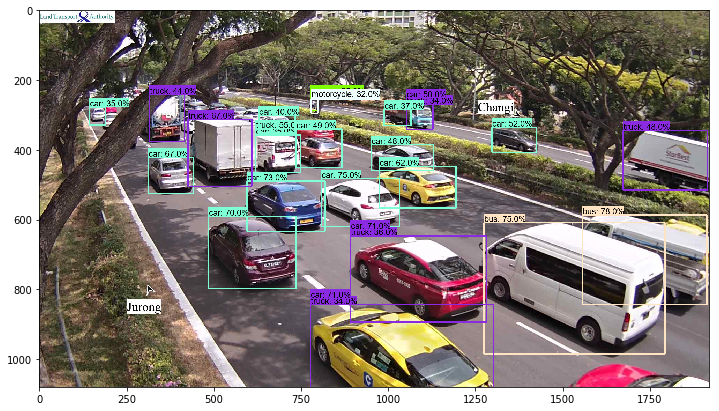

7.421227216720581

5795_1205_20200811120809_aa5561.jpg


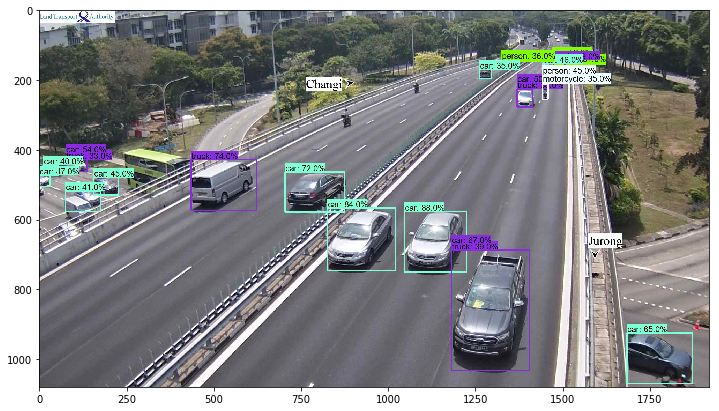

6.761079788208008

5797_1206_20200811120809_20bb86.jpg


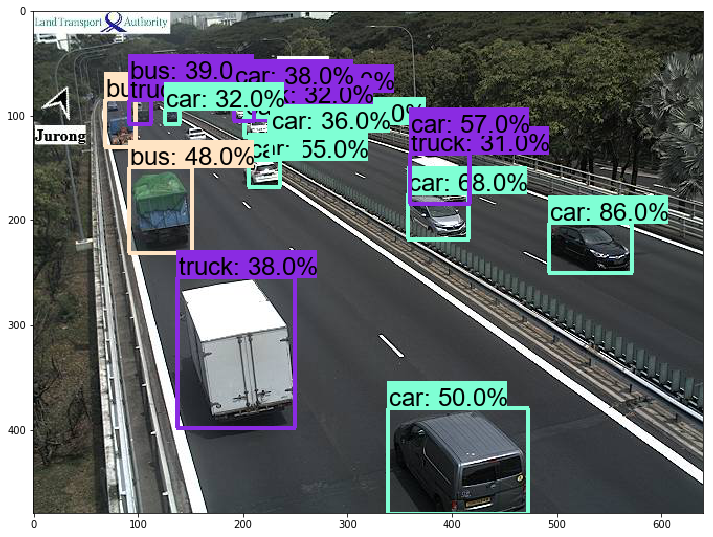

3.073168992996216

5798_1206_20200811120808_d47033.jpg


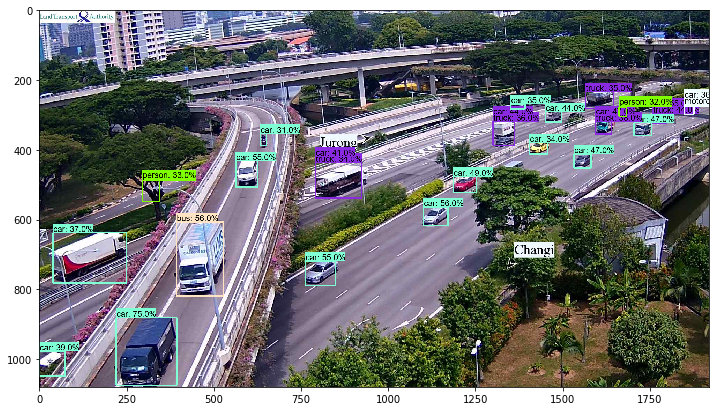

6.976774454116821

5799_1204_20200811120807_10e8e1.jpg


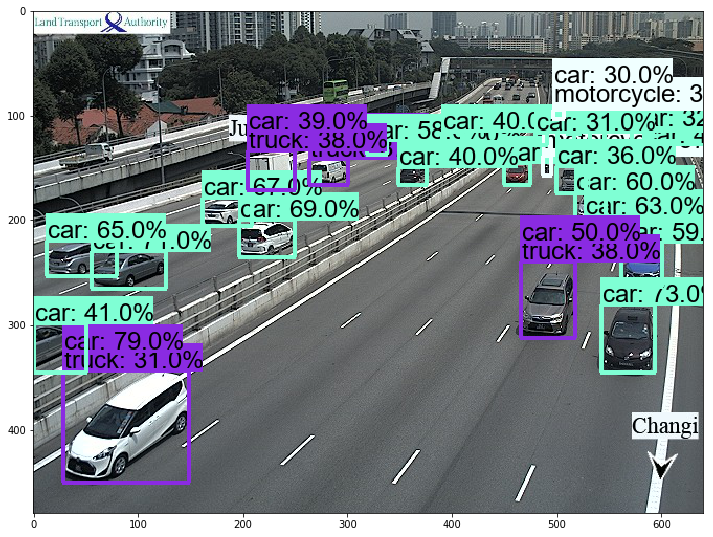

3.586956739425659

6701_1205_20200811120833_0d0197.jpg


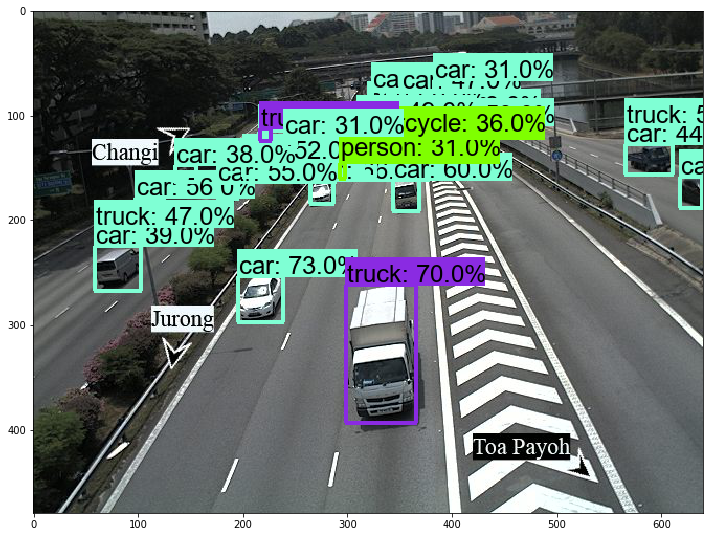

2.655056953430176

6703_1204_20200811120833_8bf022.jpg


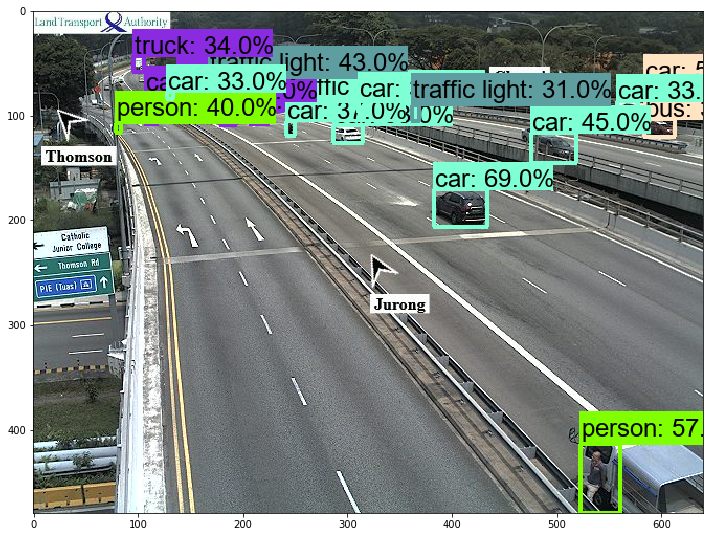

3.135211944580078

6704_1206_20200811120833_91b245.jpg


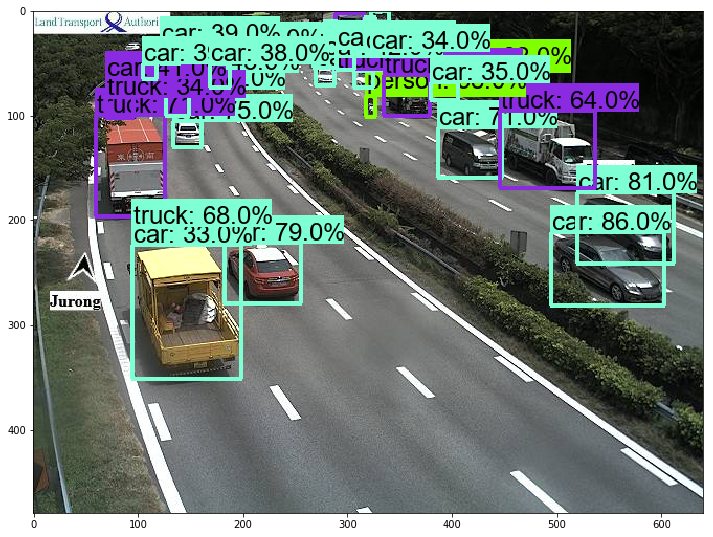

2.9182679653167725

6705_1205_20200811120833_dcbb5f.jpg


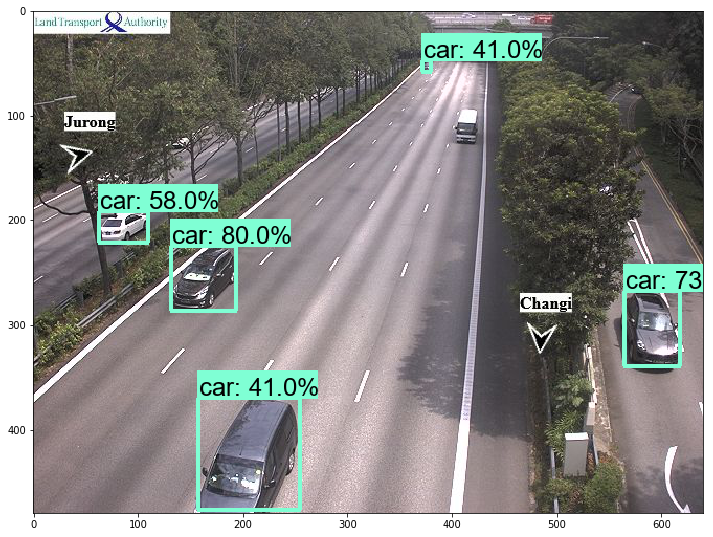

3.1207497119903564

6706_1206_20200811120833_c6dda4.jpg


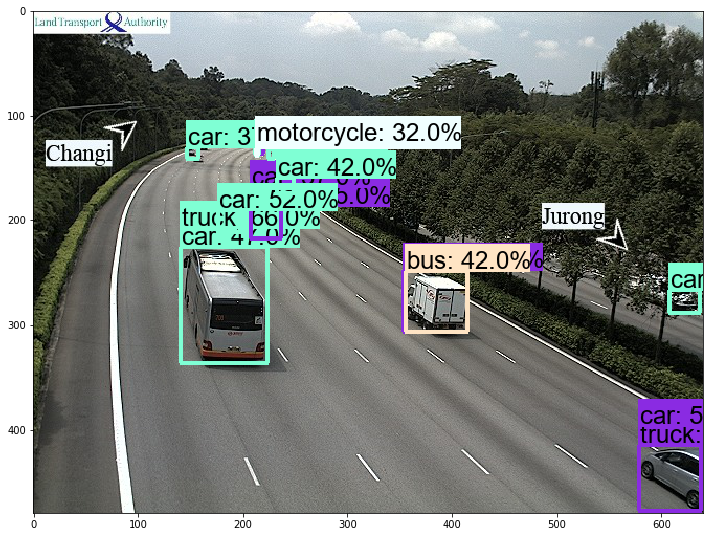

3.3650546073913574

6708_1206_20200811120833_e48e26.jpg


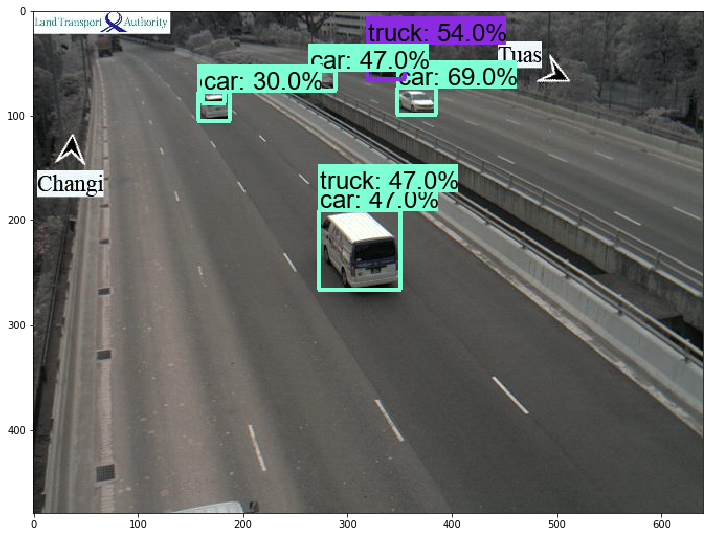

2.43951153755188

6710_1206_20200811120824_0fe194.jpg


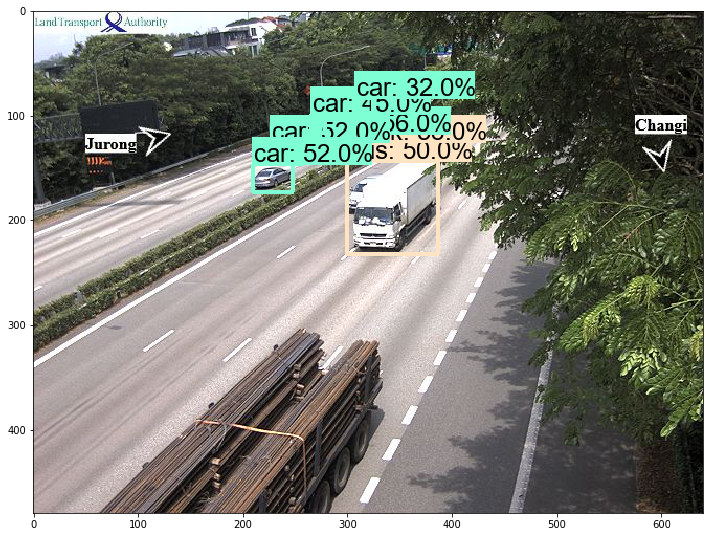

3.2256088256835938

6711_1205_20200811120824_dba8c2.jpg


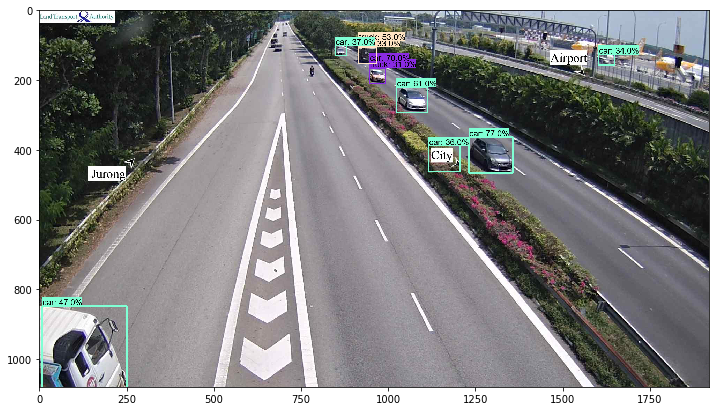

6.814811944961548

6712_1206_20200811120824_54ce14.jpg


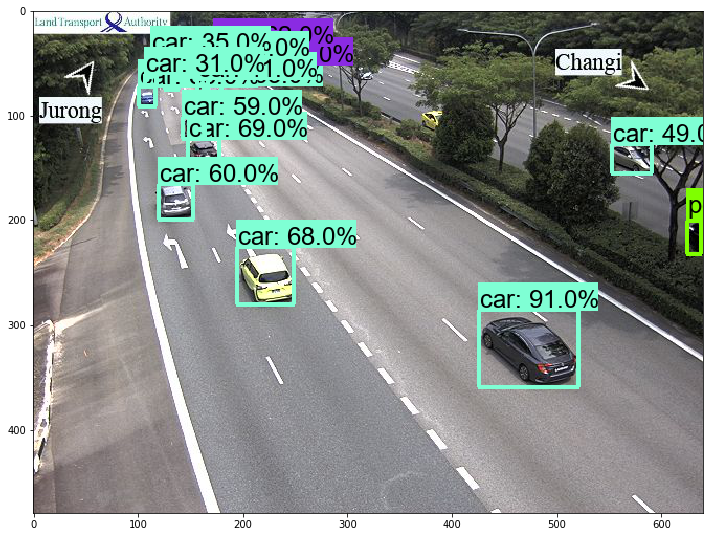

3.1634836196899414

6713_1206_20200811120822_37f5b2.jpg


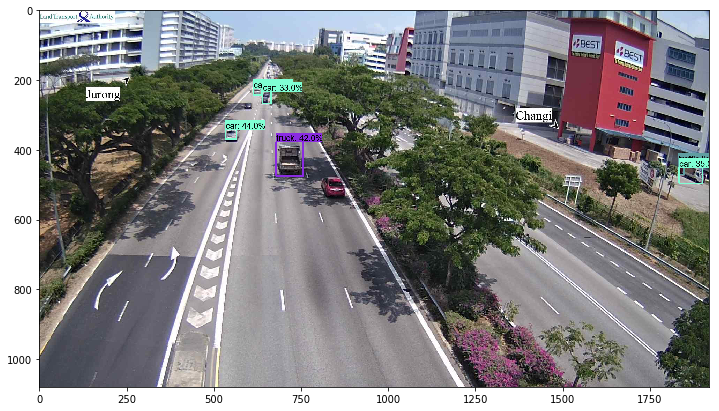

6.269970417022705

6714_1206_20200811120822_aa26c1.jpg


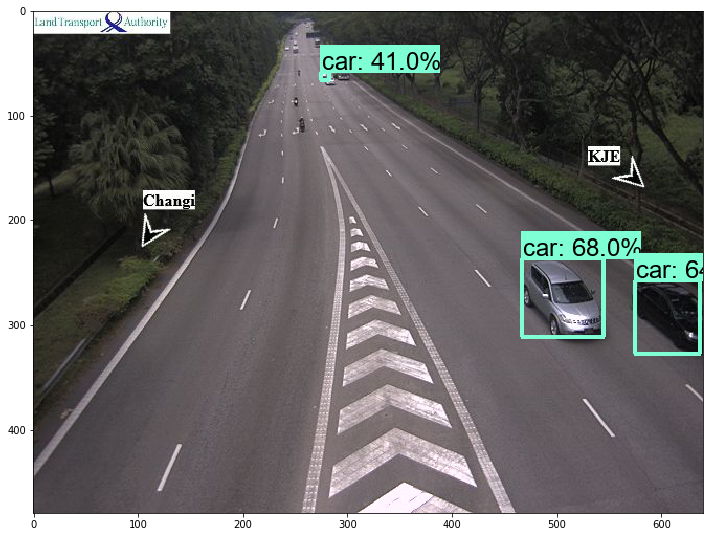

2.4547078609466553

6715_1206_20200811120822_8b3872.jpg


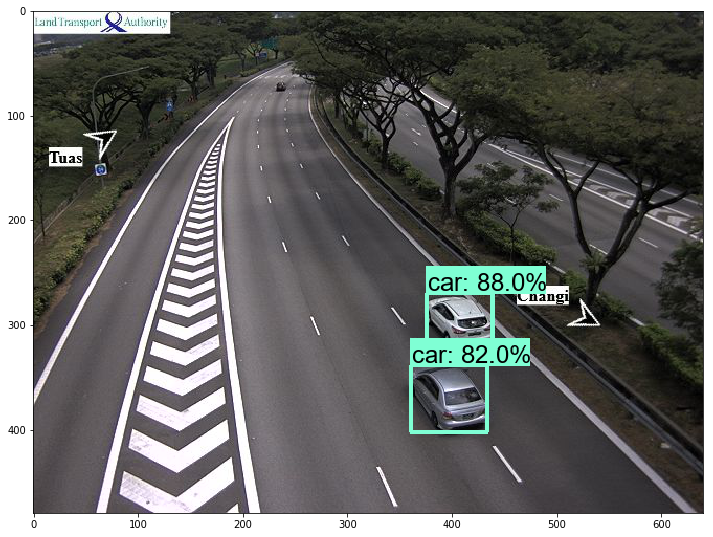

3.3034894466400146

6716_1206_20200811120821_67b731.jpg


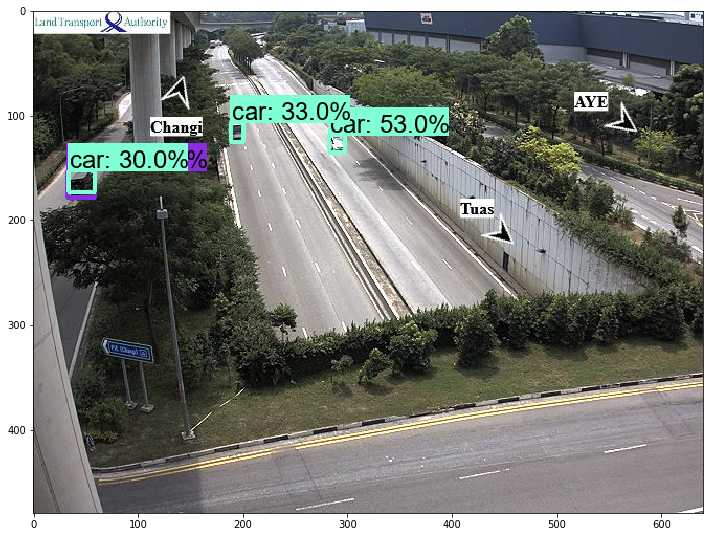

2.5472469329833984

7791_1206_20200811120817_a29d1a.jpg


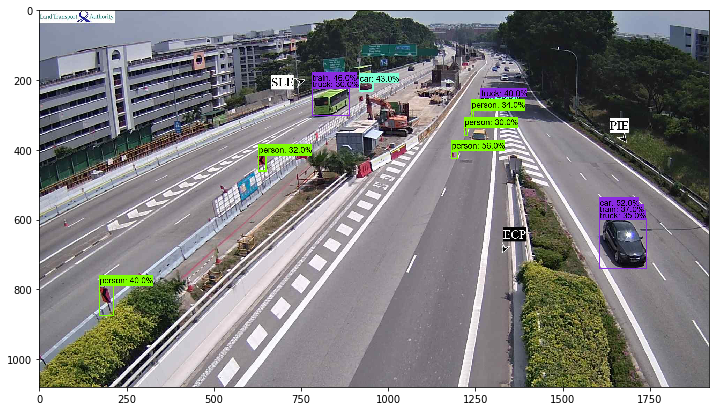

6.410657644271851

7793_1206_20200811120816_bed103.jpg


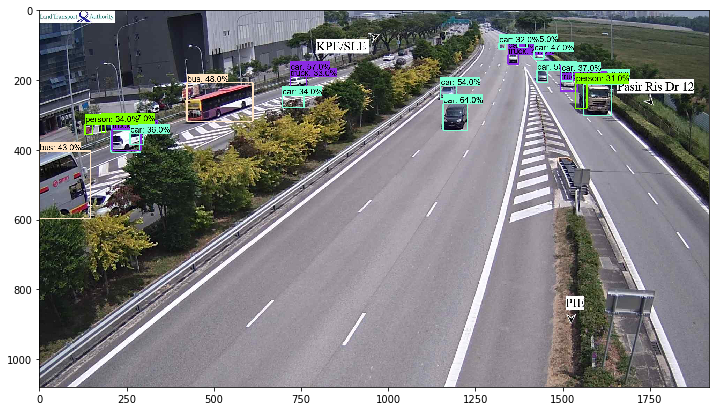

7.465740203857422

7794_1206_20200811120815_a74da0.jpg


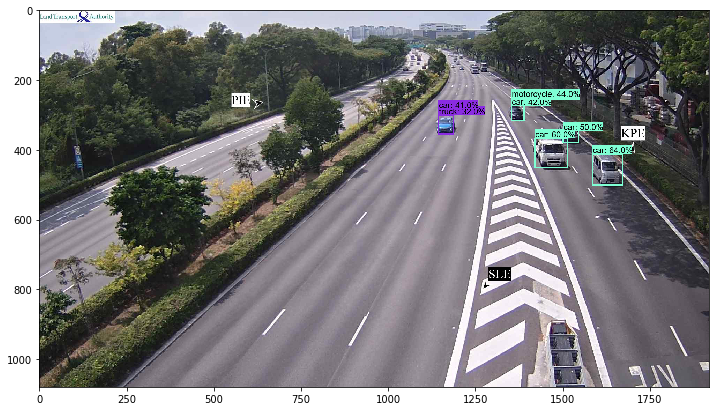

7.075371980667114

7795_1206_20200811120813_4c822b.jpg


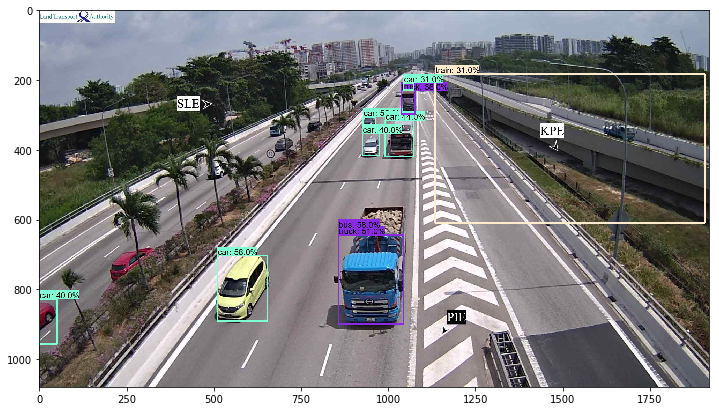

7.172455310821533

7796_1206_20200811120813_fcb4f8.jpg


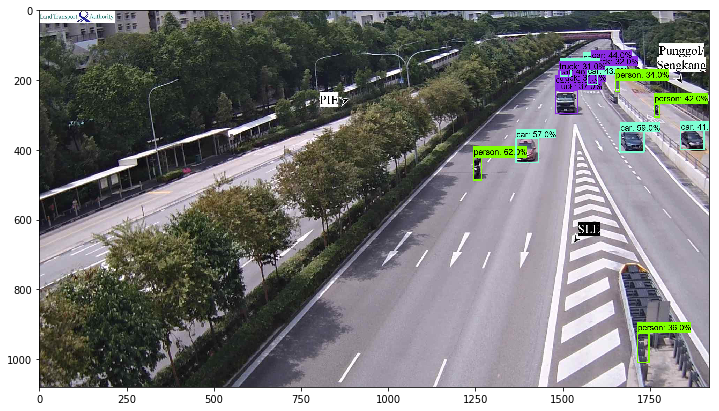

7.6002490520477295

7797_1206_20200811120812_811bd5.jpg


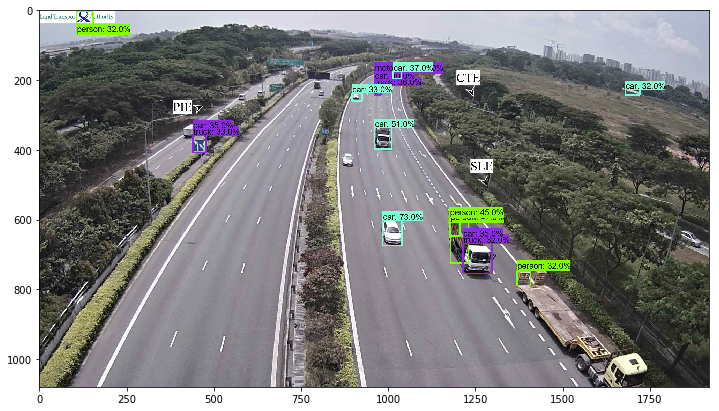

7.804469108581543

7798_1206_20200811120811_53ecf9.jpg


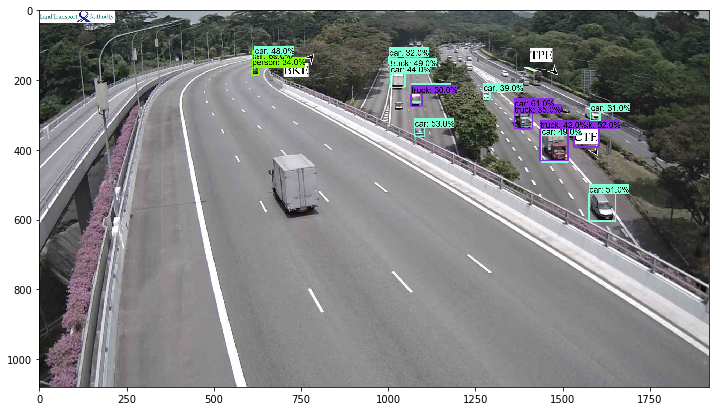

8.661655187606812

8701_1206_20200811120836_e1339d.jpg


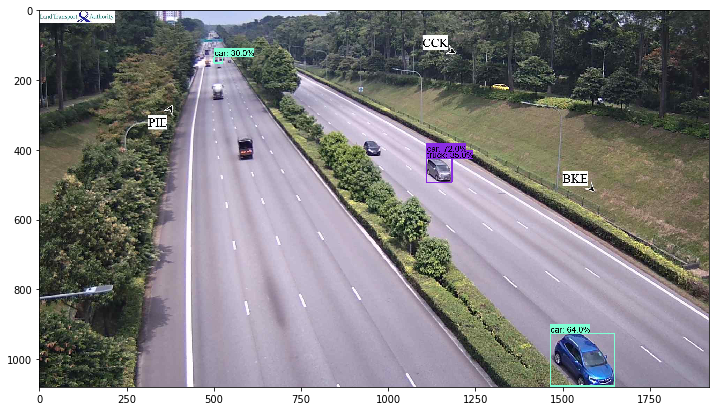

8.841765642166138

8702_1205_20200811120835_43bd01.jpg


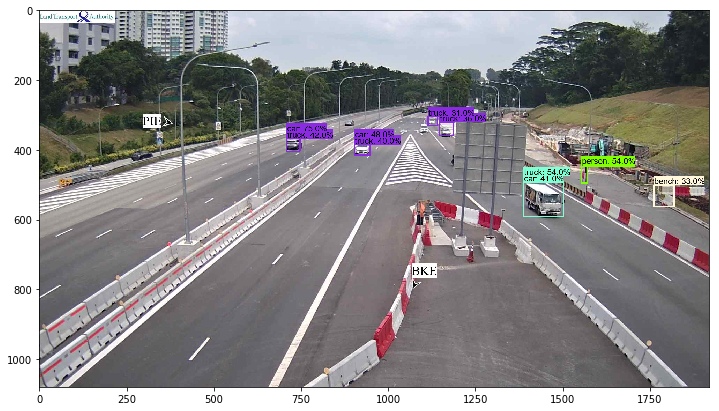

8.150920391082764

8704_1206_20200811120834_e4bacd.jpg


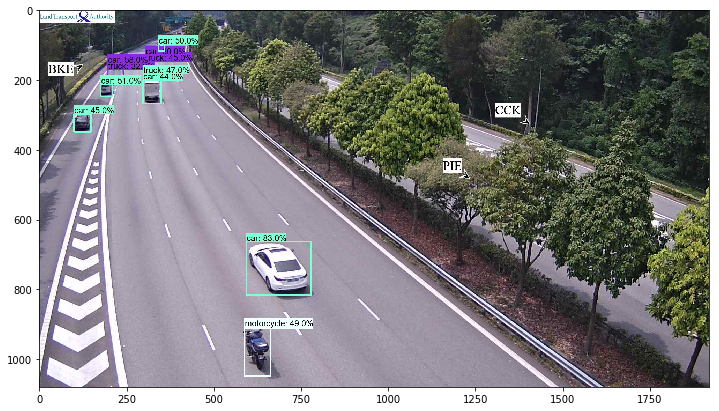

7.938086271286011

8706_1205_20200811120834_a8d07b.jpg


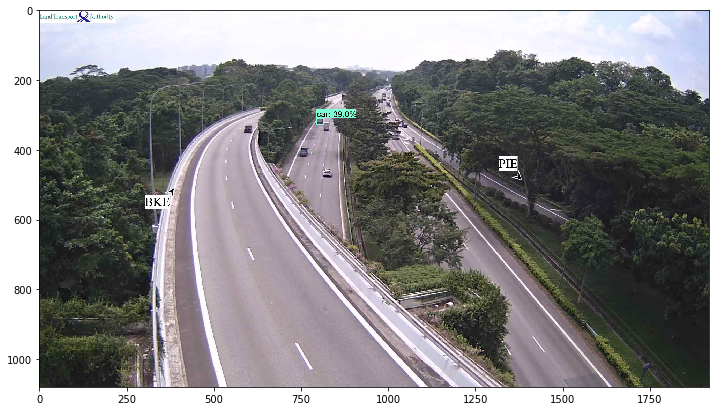

6.24864387512207

9701_1206_20200811120839_fcce92.jpg


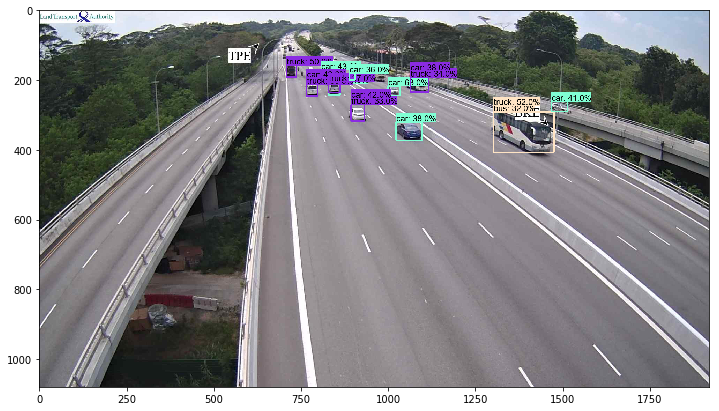

6.859583616256714

9702_1206_20200811120838_4f41e8.jpg


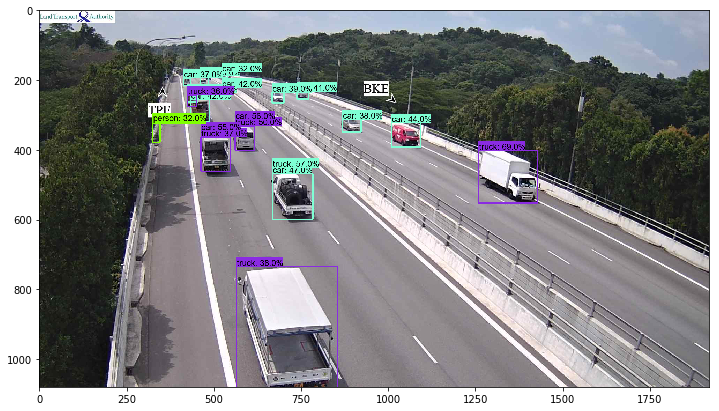

6.644440174102783

9703_1205_20200811120838_ee8eb8.jpg


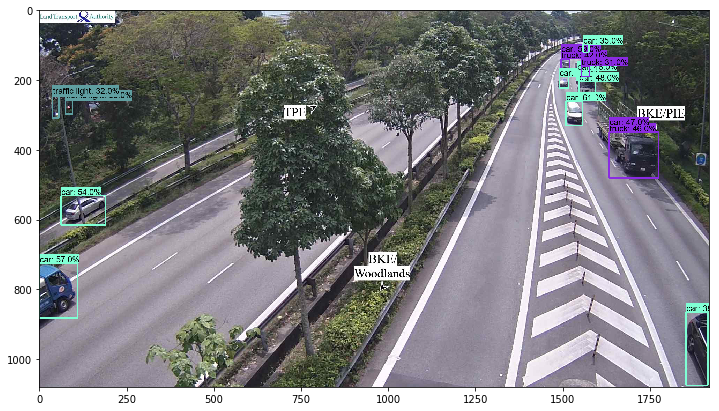

7.4606804847717285

9704_1205_20200811120837_29ae5b.jpg


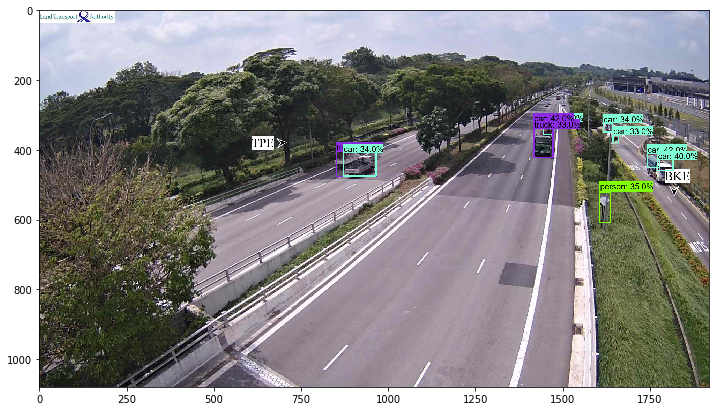

6.461693048477173

9705_1206_20200811120836_75926f.jpg


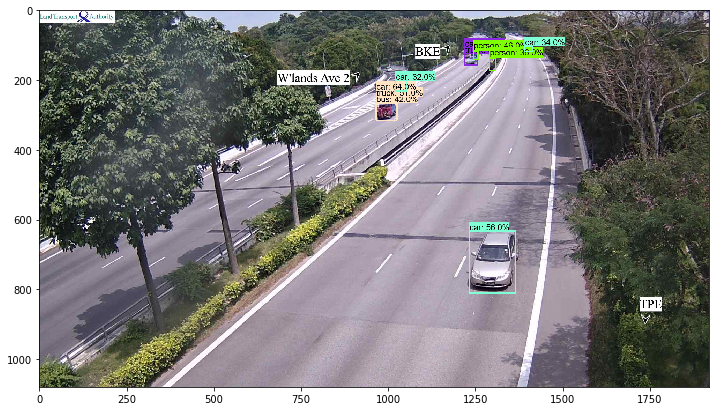

6.279273271560669

9706_1206_20200811120835_6d1140.jpg


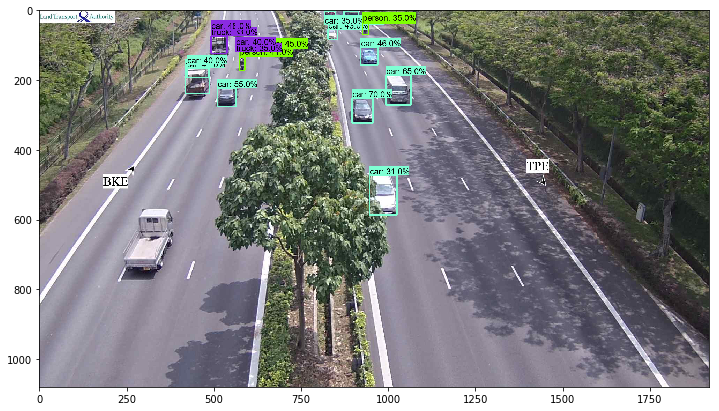

7.515687465667725

Complete. Total time: 423.69


In [13]:
s0 = time()
images = [x for x in os.listdir(data_dir) if x.endswith('.jpg')]
compiled = []


print('%s images to process'%len(images))
for image_file in images:
    s = time()
    print(image_file)
    image_path = os.path.join(data_dir, image_file)
    image_np = load_image_into_numpy_array(image_path)

    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections, predictions_dict, shapes = detect_fn(input_tensor)

    label_id_offset = 1
    
    image_np_with_detections = image_np.copy()
    # Use keypoints if available in detections
    keypoints, keypoint_scores = None, None
    if 'detection_keypoints' in detections:
        keypoints = detections['detection_keypoints'][0].numpy()
        keypoint_scores = detections['detection_keypoint_scores'][0].numpy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections,
          detections['detection_boxes'][0].numpy(),
          (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
          detections['detection_scores'][0].numpy(),
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=200,
          min_score_thresh=.30,
          agnostic_mode=False,
          keypoints=keypoints,
          keypoint_scores=keypoint_scores,
          keypoint_edges=get_keypoint_tuples(configs['eval_config']))

    plt.figure(figsize=(12,16))
    plt.imshow(image_np_with_detections)
    plt.show()
    print(time()-s)
    print()

print('Complete. Total time: %.2f'%(time()-s0))